In [1]:
import h5py 
import numpy as np 
import matplotlib.pyplot as plt 

In [2]:
h5_file = h5py.File('./tsne.h5', 'r') 

In [3]:
h5_file.keys()

<KeysViewHDF5 ['cm_predict', 'tsne']>

In [4]:
cm_predict = h5_file[u'tsne'] 
# RMSD_cm = h5_file[u'RMSD_cm'] 
# RMSD = h5_file[u'RMSD'] 

In [5]:
rmsd_prof = np.load('../traj_analysis/rmsd.npy')
RMSD = np.vstack(rmsd_prof)
RMSD.shape

(320000, 3)

In [6]:
import plotly
import plotly.graph_objs as go 

plotly.offline.init_notebook_mode(connected=True)

trace1 = go.Scatter3d(
    x=cm_predict[:,0][::], 
    y=cm_predict[:,1][::],
    z=cm_predict[:,2][::],
    mode='markers',
    marker=dict(
        size=5,
        color=RMSD[::10, 2],                # set color to an array/list of desired values
        colorbar=dict(title=''),
        colorscale='Jet',   # choose a colorscale
        opacity=1
    )
)

data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
plotly.offline.plot(fig, filename='tsne_raw.html')
plotly.offline.iplot(fig)

In [7]:
import plotly
import plotly.graph_objs as go 

plotly.offline.init_notebook_mode(connected=True)
RMSD[RMSD>20] = 20

trace1 = go.Scatter3d(
    x=cm_predict[:,0][::], 
    y=cm_predict[:,1][::],
    z=cm_predict[:,2][::],
    mode='markers',
    marker=dict(
        size=5,
        color=RMSD[::10, 2],                # set color to an array/list of desired values
        colorbar=dict(title=''),
        colorscale='Jet',   # choose a colorscale
        opacity=1
    )
)

data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
plotly.offline.plot(fig, filename='tsne_capped.html')
plotly.offline.iplot(fig)

In [8]:
dist_prof = np.load('../traj_analysis/dist.npy')
dist = np.vstack(dist_prof)
dist.shape

(320000, 2)

In [9]:
import plotly
import plotly.graph_objs as go 

plotly.offline.init_notebook_mode(connected=True)

trace1 = go.Scatter3d(
    x=cm_predict[:,0][::], 
    y=cm_predict[:,1][::],
    z=cm_predict[:,2][::],
    mode='markers',
    marker=dict(
        size=5,
        color=dist[::10, 1],                # set color to an array/list of desired values
        colorbar=dict(title=''),
        colorscale='Jet',   # choose a colorscale
        opacity=1
    )
)

data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
plotly.offline.plot(fig, filename='tsne_raw_dist.html')
plotly.offline.iplot(fig)

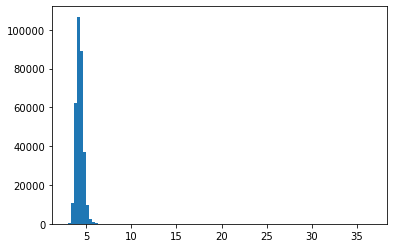

In [10]:
_ = plt.hist(dist[:,1], bins=100)

In [11]:
import plotly
import plotly.graph_objs as go 

plotly.offline.init_notebook_mode(connected=True)
RMSD[RMSD>8] = 8

trace1 = go.Scatter3d(
    x=cm_predict[:,0][::], 
    y=cm_predict[:,1][::],
    z=cm_predict[:,2][::],
    mode='markers',
    marker=dict(
        size=5,
        color=RMSD[::10, 2],                # set color to an array/list of desired values
        colorbar=dict(title=''),
        colorscale='Jet',   # choose a colorscale
        opacity=1
    )
)

data = [trace1]
layout = go.Layout(
    margin=dict(
        l=0,
        r=0,
        b=0,
        t=0
    )
)
fig = go.Figure(data=data, layout=layout)
plotly.offline.plot(fig, filename='tsne_capped_dist.html')
plotly.offline.iplot(fig)